# ARSET - Applications of Remote Sensing-Based Evapotranspiration Data Products for Agricultural and Water Resource Management

[Educational resource with source code links.](https://appliedsciences.nasa.gov/get-involved/training/english/arset-applications-remote-sensing-based-evapotranspiration-data)

##### Citation
```
(2022). ARSET - Applications of Remote Sensing-Based Evapotranspiration Data Products for Agricultural and Water Resource Management. NASA Applied Remote Sensing Training Program (ARSET). http://appliedsciences.nasa.gov/get-involved/training/english/arset-applications-remote-sensing-based-evapotranspiration-data
```
Author: Sofia Ingersoll

Date: 7 Jan 2025

These calculations were performed in Google Earth Engine and will be transformed into a nonproprietary platform (using earthengine-api). My priority first is to review all of the theory and familiarize myself with the products ArcGIS & ENVI (both available to us during the program)

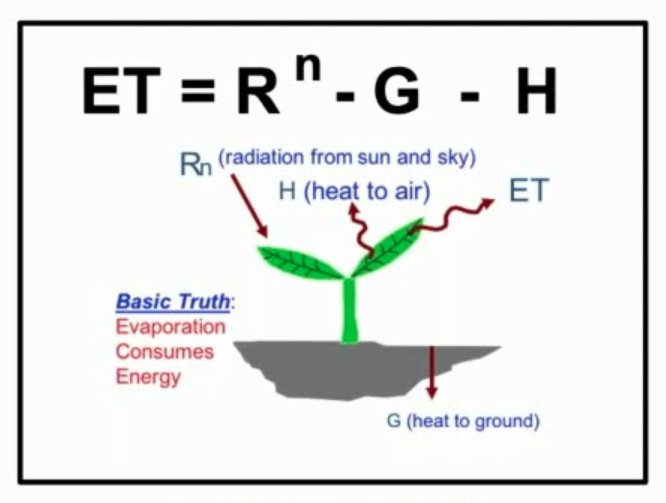

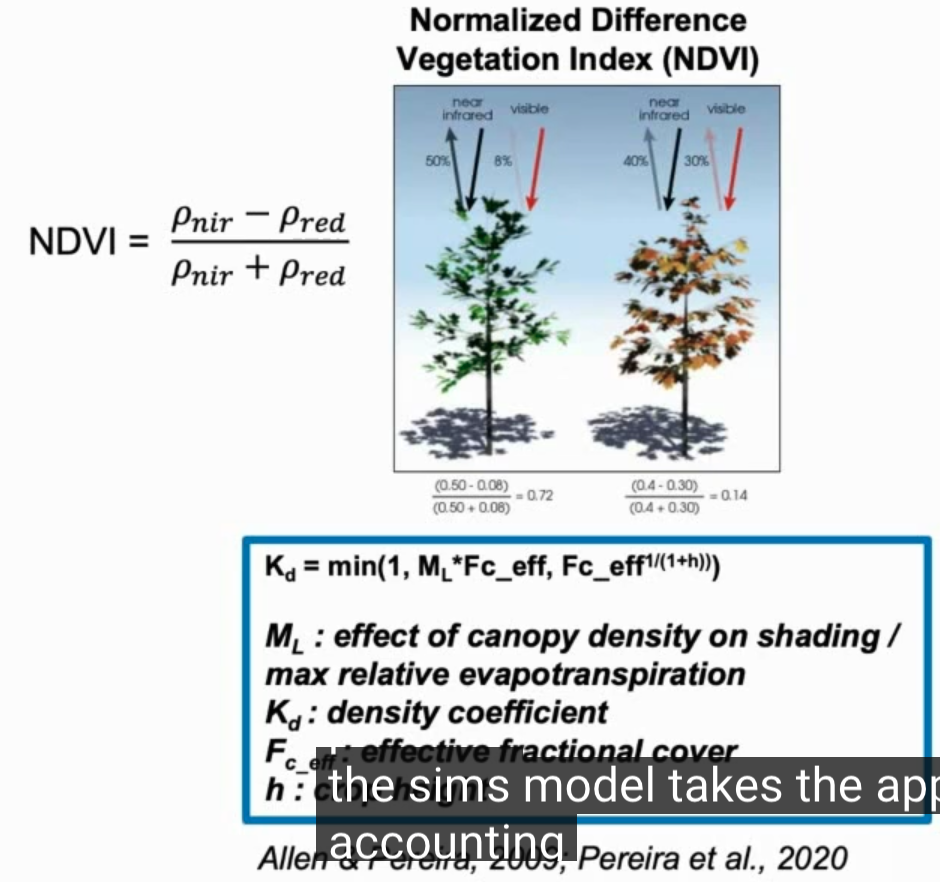

#### ECOSTRESS

Accessing the NASA Earth Data directly [here](https://appeears.earthdatacloud.nasa.gov/task/point)


We are looking at surface temperatures in Farmington, NM recorded by ECOSTRESS. 

We are going to identify our sample as `Farmington, NM ET Summer 2019` for the selected area. (area vs point in drop down)

Firstly, we will download from `ECOSTRESS Land Surface Temperature` and selected `SDS_LST` listed under the drop.

Secondly, we will grab from `ECOSTRESS Evapotranspiration PT-JPL` and select `EVAPOTRANSPIRATION_PT_JPL_ETinst` from the drop-down

Thirdly, we'll select from `ECOSTRESS Evaporative Stress Index PT-JPL` and pick `Evaporative_Stress_Index_PT_JPL_ESIavg`

Finally, we'll save from `ECOSTRESS Cloud Mask` and keep `SDS_CloudMask`

Once these are selected, we will input a time range of `07-01-2019 : 09-30-2019` in the form of a `GEOTiff` with the `Native Projection`

Alright, after organizing the selected downloads into an appropriate folder, we're going to create a QGIS map of our data. We will be customizing this with python code below. I have created a folder inside this repository to host the maps we'll be making together. It is labeled `ECOSTRESS_QGIS` within the `ARSET folder`

*Quick side note: a short list of files had difficulty downloading*
1. ECO2CLD.001_SDS_CloudMask_doy2019210230008_aid0001.tif
2. ECO2LSTE.001_SDS_LST_doy2019250143356_aid0001.tif
3. ECO2LSTE.001_SDS_LST_doy2019251071445_aid0001.tif
4. ECO2LSTE.001_SDS_LST_doy2019254125528_aid0001.tif
5. ECO2LSTE.001_SDS_LST_doy2019258111745_aid0001.tif
6. ECO2LSTE.001_SDS_LST_doy2019261102923_aid0001.tif
7. ECO2LSTE.001_SDS_LST_doy2019263022126_aid0001.tif
8. ECO2LSTE.001_SDS_LST_doy2019266080338_aid0001.tif

#### Cloud Masking Example

Okay, we are going to use python to remove the cloud cover. Firstly, we shall install mamba and use that to create our python environment: `ARSET_ECOSTRESS`

In [1]:
from os.path import join, basename, splitext
from datetime import datetime
import numpy as np
import hvplot.xarray
import rioxarray

##### Surface Temperature Data
Firstly, we will load the raw data that includes the clouds. These will register as blue on our map

In [2]:
# identify what we want to look at
ST_filename = join('..','..','Farmington NM ET Summer 2019 Raw', 'ECO2LSTE.001_SDS_LST_doy2019227233543_aid0001.tif')
# parsing time stamp from file name
datetime_UTC = datetime.strptime(splitext(basename(ST_filename))[0].split("_")[-2][3:], "%Y%j%H%M%S")
# read in the file and drop the unnecessary band dimension
ST = rioxarray.open_rasterio(ST_filename).squeeze("band", drop=True)

# let's do a quick check to preview our data
ST

<xarray.DataArray (y: 816, x: 1259)> Size: 2MB
[1027344 values with dtype=uint16]
Coordinates:
  * x            (x) float64 10kB -108.6 -108.6 -108.6 ... -107.8 -107.8 -107.8
  * y            (y) float64 7kB 36.92 36.92 36.92 36.92 ... 36.41 36.41 36.41
    spatial_ref  int64 8B 0
Attributes:
    add_offset:                  0.0
    build_id:                    601
    orbit_correction_performed:  True
    orbit_number:                6296
    scale_factor:                0.02
    scene_id:                    7
    units:                       K
    AREA_OR_POINT:               Area
    _FillValue:                  0

In [3]:
# now let's visualize our data

# we are considering how per pixel conditions capture temperature
# this is giving us an array of surface temperature in C
ST.data = np.where(ST.data == 0, np.nan, ST.data * 0.02) - 273.15

# next we'll need to reproject
ST.rio.reproject("EPSG:3857").hvplot.image(
    cmap = 'jet',
    tiles = 'OSM',
    alpha = 0.7,
    title = f'ECOSTRESS Surface Temperature {datetime_UTC:%Y-%m-%d %H:%M:%S} UTC Unmasked',
    width = 1080,
    height = 720
)

:Overlay
   .Tiles.I :Tiles   [x,y]
   .Image.I :Image   [x,y]   (value)

##### Raw Cloud Data
Inverse of our previous color mapping convention, in the cloud mask below, the areas highlighted in red contain the clouds (i.e. contain values > 1 & 2)

In [4]:
# the matching cloud file will contain the same time stamp as our ST data
cloud_filename = join("..",'..', "Farmington NM ET Summer 2019 Raw", "ECO2CLD.001_SDS_CloudMask_doy2019227233543_aid0001.tif")
# read the data
cloud = rioxarray.open_rasterio(cloud_filename).squeeze("band", drop = True)

# let's peek at it
cloud

<xarray.DataArray (y: 816, x: 1259)> Size: 2MB
[1027344 values with dtype=int16]
Coordinates:
  * x            (x) float64 10kB -108.6 -108.6 -108.6 ... -107.8 -107.8 -107.8
  * y            (y) float64 7kB 36.92 36.92 36.92 36.92 ... 36.41 36.41 36.41
    spatial_ref  int64 8B 0
Attributes:
    add_offset:                  0.0
    build_id:                    601
    orbit_correction_performed:  True
    orbit_number:                6296
    scale_factor:                1.0
    scene_id:                    7
    units:                       Bit-field
    AREA_OR_POINT:               Area
    _FillValue:                  -999

There is a whole rabbit-hole to fall into to understand bits, their powers being multiples of 2, and how bit movements come into play when masking.

When we shift to the right, we are essentially dividing by 2 each time we move. To create a mask, we assess the binary value of the bit in the farthest most right position. If it's 1, we keep, if it's 0, we mask. Honestly, this topic is funky.

In [5]:
# create a binary cloud mask
# this step bit-shifts our array two bits to the right, 
# then it checks if the right most bit has a value of 0 or 1
# this makes our mask
cloud.data = (cloud.data >> 2) & 1

# now let's visualize
cloud.rio.reproject("EPSG:3857").hvplot.image(
    cmap = "jet",
    tiles = 'OSM',
    alpha = 0.7,
    title = f'ECOSTRESS Cloud Mask {datetime_UTC:%Y-%m-%d %H:%M:%S} UTC',
    width = 1080,
    height = 720
)

:Overlay
   .Tiles.I :Tiles   [x,y]
   .Image.I :Image   [x,y]   (value)

##### Cloud Masked Surface Temperature Map

In [6]:
# combining the data
# if the cloud mask is true, we set that value to NAN and effectively remove it from our plot data
ST.data = np.where(cloud.data, np.nan, ST.data)

# peep
ST

<xarray.DataArray (y: 816, x: 1259)> Size: 8MB
array([[42.19, 42.37, 42.57, ..., 38.47, 37.01, 37.01],
       [42.05, 42.75, 42.79, ..., 38.57, 37.79, 36.47],
       [42.31, 42.31, 42.79, ..., 38.57, 38.43, 36.47],
       ...,
       [43.93, 44.35, 43.87, ..., 36.51, 37.03, 36.97],
       [44.27, 44.05, 44.27, ..., 36.49, 36.85, 36.95],
       [44.09, 43.73, 43.99, ..., 36.49, 36.85, 36.67]])
Coordinates:
  * x            (x) float64 10kB -108.6 -108.6 -108.6 ... -107.8 -107.8 -107.8
  * y            (y) float64 7kB 36.92 36.92 36.92 36.92 ... 36.41 36.41 36.41
    spatial_ref  int64 8B 0
Attributes:
    add_offset:                  0.0
    build_id:                    601
    orbit_correction_performed:  True
    orbit_number:                6296
    scale_factor:                0.02
    scene_id:                    7
    units:                       K
    AREA_OR_POINT:               Area
    _FillValue:                  0

In [7]:
# visualize
ST.rio.reproject("EPSG:3857").hvplot.image(
    cmap = 'jet',
    tiles = 'OSM',
    alpha = 0.7,
    title = f'ECOSTRESS Surface Temperature {datetime_UTC:%Y-%m-%d %H:%M%:%S} UTC Masked',
    width = 1080,
    height = 720
)

:Overlay
   .Tiles.I :Tiles   [x,y]
   .Image.I :Image   [x,y]   (value)

### Example 2

#####  All Data Processing: Farmington, NM Surface Temperature 2019

In [20]:
# load missing libraries
from os import makedirs
import pandas as pd
from glob import glob
from datetime import datetime
import numpy as np
import rioxarray as rioxr
import rioxarray.merge
import hvplot.xarray
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
import xarray as xr
from os.path import join, basename, splitext

In [10]:
# reuseable variables for our system settings
input_directory = join('..','..','Farmington NM ET Summer 2019 Raw')
output_directory = join('..', '..', 'Farmington NM ET Summer 2019 Processed')

makedirs(output_directory, exist_ok = True)

pd.set_option("display.max_colwidth", None)

In [13]:
# load all of the raw ST data
# keeping the datetime sections flexible w/ **
ST_raw_filenames = pd.DataFrame({'ST_raw_filename': sorted(glob(join('..','..','Farmington NM ET Summer 2019 Raw',"*LST_*.tif")))})

# parse the dates from file name
ST_raw_filenames['datetime_UTC'] = ST_raw_filenames.ST_raw_filename.apply(lambda ST_raw_filename: datetime.strptime(splitext(basename(ST_raw_filename))[0].split("_")[-2][3:], "%Y%j%H%M%S"))

# peek
ST_raw_filenames
ST_raw_filenames[:6]

,ST_raw_filename,datetime_UTC
0,../../Farmington NM ET Summer 2019 Raw/ECO2LST...,2019-07-02 17:13:55
1,../../Farmington NM ET Summer 2019 Raw/ECO2LST...,2019-07-02 17:14:47
2,../../Farmington NM ET Summer 2019 Raw/ECO2LST...,2019-07-03 16:24:31
3,../../Farmington NM ET Summer 2019 Raw/ECO2LST...,2019-07-06 15:33:17
4,../../Farmington NM ET Summer 2019 Raw/ECO2LST...,2019-07-06 15:34:08
5,../../Farmington NM ET Summer 2019 Raw/ECO2LST...,2019-07-07 08:13:46


In [12]:
# load all the cloud data
cloud_filenames = pd.DataFrame({'cloud_filename': sorted(glob(join('..','..','Farmington NM ET Summer 2019 Raw',"*_CloudMask_*.tif")))})
# parse dates from filenames
cloud_filenames["datetime_UTC"] = cloud_filenames.cloud_filename.apply(lambda cloud_filename: datetime.strptime(splitext(basename(cloud_filename))[0].split("_")[-2][3:], "%Y%j%H%M%S"))

# check
cloud_filenames
cloud_filenames[:6] 

,cloud_filename,datetime_UTC
0,../../Farmington NM ET Summer 2019 Raw/ECO2CLD...,2019-07-02 17:13:55
1,../../Farmington NM ET Summer 2019 Raw/ECO2CLD...,2019-07-02 17:14:47
2,../../Farmington NM ET Summer 2019 Raw/ECO2CLD...,2019-07-03 16:24:31
3,../../Farmington NM ET Summer 2019 Raw/ECO2CLD...,2019-07-06 15:33:17
4,../../Farmington NM ET Summer 2019 Raw/ECO2CLD...,2019-07-06 15:34:08
5,../../Farmington NM ET Summer 2019 Raw/ECO2CLD...,2019-07-07 08:13:46


In [14]:
# combine the data
ST_filenames = pd.merge(ST_raw_filenames, cloud_filenames)

# create a column for masked files
ST_filenames['ST_masked_filename'] = ST_filenames.datetime_UTC.apply(lambda datetime_UTC: join(output_directory, f"{datetime_UTC: %Y.%m.%d.%H,%M.%S}_ST.tif"))
# reorder the columns
ST_filenames = ST_filenames[['datetime_UTC', 'ST_raw_filename', 'cloud_filename', 'ST_masked_filename']]

# peep
ST_filenames
ST_filenames[:6]


,datetime_UTC,ST_raw_filename,cloud_filename,ST_masked_filename
0,2019-07-02 17:13:55,../../Farmington NM ET Summer 2019 Raw/ECO2LST...,../../Farmington NM ET Summer 2019 Raw/ECO2CLD...,../../Farmington NM ET Summer 2019 Processed/ ...
1,2019-07-02 17:14:47,../../Farmington NM ET Summer 2019 Raw/ECO2LST...,../../Farmington NM ET Summer 2019 Raw/ECO2CLD...,../../Farmington NM ET Summer 2019 Processed/ ...
2,2019-07-03 16:24:31,../../Farmington NM ET Summer 2019 Raw/ECO2LST...,../../Farmington NM ET Summer 2019 Raw/ECO2CLD...,../../Farmington NM ET Summer 2019 Processed/ ...
3,2019-07-06 15:33:17,../../Farmington NM ET Summer 2019 Raw/ECO2LST...,../../Farmington NM ET Summer 2019 Raw/ECO2CLD...,../../Farmington NM ET Summer 2019 Processed/ ...
4,2019-07-06 15:34:08,../../Farmington NM ET Summer 2019 Raw/ECO2LST...,../../Farmington NM ET Summer 2019 Raw/ECO2CLD...,../../Farmington NM ET Summer 2019 Processed/ ...
5,2019-07-07 08:13:46,../../Farmington NM ET Summer 2019 Raw/ECO2LST...,../../Farmington NM ET Summer 2019 Raw/ECO2CLD...,../../Farmington NM ET Summer 2019 Processed/ ...


### Updating Tutorial Code

Below is my workflow to update the tutorial code before creating a for-loop to process all of the data

In [15]:
# ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
# ----    The following code chunk is an attempt to update the tutorial code and work around errors presented in the for loop following this   ----
# ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
# read and wrangle single file of ST data
ST = rioxarray.open_rasterio(ST_filenames['ST_raw_filename'][59]).squeeze("band", drop = True)
    # convert raw image to surface temp (apply scale factor & convert from K to C)
ST.data = np.where(ST.data == 0, np.nan, ST.data * 0.02) - 273.15

    # read and wrangle matching cloud file
cloud = rioxarray.open_rasterio(cloud_filenames['cloud_filename'][59]).squeeze("band", drop = True).rio.reproject_match(ST)
cloud.data = (cloud.data >> 2) & 1

    # now remove the clouds using the mask
ST.data = np.where(cloud.data, np.nan, ST.data)
    #ST.compute()

    # okay having some difficulties following the tutorial verbatim
    # we will copy the data before clipping it, in an attempt to work around the error codes
clipped_data = ST.data.copy()
    
    # define an accepted quantile range for pixel cloud values
low, high = np.nanquantile(ST.data, [0.08, 0.98])
    # applying the copied data to be clipped
clipped_data = np.where((clipped_data < low) | (clipped_data > high), np.nan, ST.data)

    # consider the number of nonzero/nan values and divide by the size of the data
    # this is the proportion of the data that is masked (by clouds)
missing_proportion = np.count_nonzero(np.isnan(clipped_data.data)) / ST.data.size
print(f'missing proportion: {missing_proportion * 100}%')

    # Embedding a control for our quality of data considered
    # if more than half of the data is missing, we will not consider the masked version  
if missing_proportion > 0.5:
    pass

else:
    
    # setting up figure
    # this needs to be done for imshow otherwise we get axes starting at 0 (wa-wa)
    extent = [
        # min long
        ST.rio.bounds()[0],
        # max long
        ST.rio.bounds()[2],
        # min lat
        ST.rio.bounds()[1],
        # max lat
        ST.rio.bounds()[3]      
    ]
    
    fig, ax = plt.subplots(1, 1, 
                           facecolor = "white",
                           figsize = (10,7)
                           )

    
    # replacing ST.rio.to_raster(ST_filenames['ST_masked_filename'][59])
    # creating a raster display
    raster_img = ax.imshow(clipped_data, 
                           cmap = "jet",
                           extent = extent,
                           origin= 'upper')
    
    # customizations
    ax.set_title(f"Farmington, NM: {ST_filenames['datetime_UTC'][59]}\nFilename: {ST_filenames['ST_masked_filename'][59]}", 
                fontsize = 14)
    #ax.text(0.5, 1.05,
     #       f"Filename: {ST_filenames['ST_masked_filename'][59]}",
      #      ha = 'center',
       #     fontsize = 10)
    ax.set_xlabel('Longitude',
                  fontsize = 12)
    ax.set_ylabel('Latitude',
                  fontsize = 12)
    
    # colorbar legend
    cbar = fig.colorbar(raster_img,
                        ax = ax,
                        orientation = "horizontal",
                        fraction = 0.046,
                        pad = 0.1
                        )
    cbar.set_label('Surface Temperature (°C)')

    # now save our figure and close
    plt.savefig(ST_filenames['ST_masked_filename'][59].replace('.tif','.png'),
                dpi = 300,
                bbox_inches= "tight")
    
    plt.close(fig)

missing proportion: 38.5189381550873%


### Implementing my changes

So we successfully updated the code to provide us a more informative data visualization.

#### `This area is flagged for future improvements`
Ideally, I would include the ST_masked_file name smaller as a suptitle or ax.text below the title, but for the sake of this exercise, I will save that for a later day and apply the changes above to the for-loop below.

In the future, I would prefer to make this a function I can pass a single data array through. However I need to keep working through the large volume of training material. 

In [19]:
# using a for loop we are going to 


for file, (datetime_UTC, ST_raw_filename, cloud_filename, ST_masked_filename) in ST_filenames.iterrows():
    
    # provide identification information, doing it by row prints out prettier than in one print
    print(f'time: {datetime_UTC}')
    print(f'ST raw file: {ST_raw_filename}')
    print(f'cloud file:{cloud_filename}')
    print(f'ST masked file: {ST_masked_filename}')
         
    # read and wrangle single file of ST data
    ST = rioxarray.open_rasterio(ST_raw_filename).squeeze("band", drop = True).rio.reproject("EPSG:3857")
    # convert raw image to surface temp (apply scale factor & convert from K to C)
    ST.data = np.where(ST.data == 0, np.nan, ST.data * 0.02) - 273.15

    # read and wrangle matching cloud file
    cloud = rioxarray.open_rasterio(cloud_filename).squeeze("band", drop = True).rio.reproject_match(ST)
    cloud.data = (cloud.data >> 2) & 1

    # now remove the clouds using the mask
    ST.data = np.where(cloud.data, np.nan, ST.data)
    #ST.compute()

    # okay having some difficulties following the tutorial verbatim
    # we will copy the data before clipping it, in an attempt to work around the error codes
    clipped_data = ST.data.copy()
    
    # define an accepted quantile range for pixel cloud values
    low, high = np.nanquantile(ST.data, [0.08, 0.98])
    # applying the copied data to be clipped
    clipped_data = np.where((clipped_data < low) | (clipped_data > high), np.nan, clipped_data.data)

    # consider the number of nonzero/nan values and divide by the size of the data
    # this is the proportion of the data that is masked (by clouds)
    missing_proportion = np.count_nonzero(np.isnan(clipped_data.data)) / ST.data.size
    print(f'missing proportion: {missing_proportion * 100}%')

    # Embedding a control for our quality of data considered
    # if more than half of the data is missing, we will not consider the masked version  
    if missing_proportion > 0.5:
        pass

    else:
    
    # setting up figure
    # this needs to be done for imshow otherwise we get axes starting at 0 (wa-wa)
        extent = [
        # min long
            ST.rio.bounds()[0],
        # max long
            ST.rio.bounds()[2],
        # min lat
            ST.rio.bounds()[1],
        # max lat
            ST.rio.bounds()[3]      
        ]
    
        fig, ax = plt.subplots(1, 1, 
                               facecolor = "white",
                               figsize = (10,7)
                               )

    
    # replacing ST.rio.to_raster(ST_filenames['ST_masked_filename'][59])
    # creating a raster display
        raster_img = ax.imshow(clipped_data, 
                            cmap = "jet",
                            extent = extent,
                            origin= 'upper')
    
    # customizations
        ax.set_title(f"Farmington, NM: {datetime_UTC}\nFilename: {ST_masked_filename}", 
                    fontsize = 14)
        ax.set_xlabel('Longitude',
                    fontsize = 12)
        ax.set_ylabel('Latitude',
                    fontsize = 12)
    
    # colorbar legend
        cbar = fig.colorbar(raster_img,
                            ax=ax,
                            orientation = "horizontal",
                            # adjusts size of cbar
                            fraction = 0.046,
                            # adjust spacing between cbar & plot
                            pad = 0.1
                            )
        cbar.set_label('Surface Temperature (°C)')

    # now save our figure as a tiff and pgn in our output directory and close
        plt.savefig(ST_masked_filename.replace('.tif','.png'),
                    dpi = 300,
                    bbox_inches= "tight")
    
        plt.close(fig)

time: 2019-07-02 17:13:55
ST raw file: ../../Farmington NM ET Summer 2019 Raw/ECO2LSTE.001_SDS_LST_doy2019183171355_aid0001.tif
cloud file:../../Farmington NM ET Summer 2019 Raw/ECO2CLD.001_SDS_CloudMask_doy2019183171355_aid0001.tif
ST masked file: ../../Farmington NM ET Summer 2019 Processed/ 2019.07.02.17,13.55_ST.tif
missing proportion: 38.81311969208886%
time: 2019-07-02 17:14:47
ST raw file: ../../Farmington NM ET Summer 2019 Raw/ECO2LSTE.001_SDS_LST_doy2019183171447_aid0001.tif
cloud file:../../Farmington NM ET Summer 2019 Raw/ECO2CLD.001_SDS_CloudMask_doy2019183171447_aid0001.tif
ST masked file: ../../Farmington NM ET Summer 2019 Processed/ 2019.07.02.17,14.47_ST.tif
missing proportion: 96.23824246930974%
time: 2019-07-03 16:24:31
ST raw file: ../../Farmington NM ET Summer 2019 Raw/ECO2LSTE.001_SDS_LST_doy2019184162431_aid0001.tif
cloud file:../../Farmington NM ET Summer 2019 Raw/ECO2CLD.001_SDS_CloudMask_doy2019184162431_aid0001.tif
ST masked file: ../../Farmington NM ET Summer

/opt/anaconda3/envs/ARSET_ECOSTRESS/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1545: RuntimeWarning: All-NaN slice encountered
  return _nanquantile_unchecked(


missing proportion: 95.44170827369962%
time: 2019-09-18 10:29:23
ST raw file: ../../Farmington NM ET Summer 2019 Raw/ECO2LSTE.001_SDS_LST_doy2019261102923_aid0001.tif
cloud file:../../Farmington NM ET Summer 2019 Raw/ECO2CLD.001_SDS_CloudMask_doy2019261102923_aid0001.tif
ST masked file: ../../Farmington NM ET Summer 2019 Processed/ 2019.09.18.10,29.23_ST.tif
missing proportion: 24.82747193118543%
time: 2019-09-19 09:40:05
ST raw file: ../../Farmington NM ET Summer 2019 Raw/ECO2LSTE.001_SDS_LST_doy2019262094005_aid0001.tif
cloud file:../../Farmington NM ET Summer 2019 Raw/ECO2CLD.001_SDS_CloudMask_doy2019262094005_aid0001.tif
ST masked file: ../../Farmington NM ET Summer 2019 Processed/ 2019.09.19.09,40.05_ST.tif
missing proportion: 61.57248255234297%
time: 2019-09-19 09:40:57
ST raw file: ../../Farmington NM ET Summer 2019 Raw/ECO2LSTE.001_SDS_LST_doy2019262094057_aid0001.tif
cloud file:../../Farmington NM ET Summer 2019 Raw/ECO2CLD.001_SDS_CloudMask_doy2019262094057_aid0001.tif
ST mas

/opt/anaconda3/envs/ARSET_ECOSTRESS/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1545: RuntimeWarning: All-NaN slice encountered
  return _nanquantile_unchecked(


missing proportion: 9.879149242681926%


### Making a Seasonal Composite
Now that we have all of our filenames and their associated datetimes organized into a DataFrame, we will work with our data

In [23]:
# collect the names of the files we just made
ST_masked_filenames = sorted(glob(join(output_directory, "*_ST.tif")))

# let's open those rasters
ST_masked_rasters = [rioxr.open_rasterio(filename).squeeze("band", drop=True) for filename in ST_masked_filenames]

# creating a composite
ST_composite = rioxr.merge.merge_arrays(ST_masked_rasters, nodata=np.nan)

# using the median, reprojecting the composite to match og rasters (epgs 3857)
ST_composite.data = np.nanmedian(np.stack([raster.rio.reproject_match(ST_composite).data for raster in ST_masked_rasters]), axis=0)

# assign all zero values as NAN
ST_composite.data = np.where(ST_composite.data == 0, np.nan, ST_composite.data)

ST_composite

/var/folders/n4/2w_c819n7nv4fr_mvn5wpsnc0000gn/T/ipykernel_99043/2551973067.py:11: RuntimeWarning: All-NaN slice encountered
  ST_composite.data = np.nanmedian(np.stack([raster.rio.reproject_match(ST_composite).data for raster in ST_masked_rasters]), axis=0)


<xarray.DataArray (y: 816, x: 1259)> Size: 8MB
array([[ 8.29,  7.99,  8.71, ...,   nan,   nan,   nan],
       [ 9.55,  9.29,  9.29, ...,   nan,   nan,   nan],
       [10.67, 10.51, 10.95, ...,   nan,   nan,   nan],
       ...,
       [10.65, 10.87, 11.01, ...,   nan,   nan,   nan],
       [10.65, 11.47, 11.07, ...,   nan,   nan,   nan],
       [11.05, 11.05, 11.07, ...,   nan,   nan,   nan]])
Coordinates:
  * x            (x) float64 10kB -108.6 -108.6 -108.6 ... -107.8 -107.8 -107.8
  * y            (y) float64 7kB 36.92 36.92 36.92 36.92 ... 36.41 36.41 36.41
    spatial_ref  int64 8B 0
Attributes:
    build_id:                    601
    orbit_correction_performed:  True
    orbit_number:                6708
    scene_id:                    8
    units:                       K
    AREA_OR_POINT:               Area
    _FillValue:                  nan
    scale_factor:                0.02
    add_offset:                  0.0

In [22]:
# collect the names of the files we just made
ST_masked_filenames = sorted(glob(join(output_directory, "*_ST.tif")))

# let's open those rasters
ST_masked_rasters = [rioxr.open_rasterio(filename).squeeze("band", drop=True) for filename in ST_masked_filenames]

# creating a composite
ST_composite = rioxr.merge.merge_arrays(ST_masked_rasters, nodata=np.nan)

# using the median, reprojecting the composite to match og rasters (epgs 3857)
ST_composite.data = np.nanmedian(np.stack([raster.rio.reproject_match(ST_composite).data for raster in ST_masked_rasters]), axis=0)

# assign all zero values as NAN
ST_composite.data = np.where(ST_composite.data == 0, np.nan, ST_composite.data)

# rasterize to visualize
ST_composite.rio.to_raster['Farmington_ST_Median_Summer_2019.tif']

ST_composite.rio.reproject('EPSG: 3857').hvplot.image(
    
    cmap='jet',
    tiles='OSM',
    alpha= 0.7,
    title= 'ECOSTRESS Surface Temperature Summer Median 2019',
    width= 1020,
    height= 720,
    clim= tuple(np.nanquantile(ST_composite.data, [0.02, 0.98]))

)

/var/folders/n4/2w_c819n7nv4fr_mvn5wpsnc0000gn/T/ipykernel_99043/1519398898.py:11: RuntimeWarning: All-NaN slice encountered
  ST_composite.data = np.nanmedian(np.stack([raster.rio.reproject_match(ST_composite).data for raster in ST_masked_rasters]), axis=0)


TypeError: 'method' object is not subscriptable